In [656]:
include("../code/ldgm.jl")
include("../code/ldpc_graph.jl")
include("../code/bp.jl")

plot_rdb (generic function with 1 method)

## BP

In [228]:
lambda = zeros(7); lambda[7] = 1
rho = [0.00, 0.267598, 0.25537, 0.076598, 0, 0, 0, 0, 0.39233]
Lambda,Rho = edges2nodes(lambda, rho)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0], [0.0, 0.47503043913819326, 0.30221581935769426, 0.06798702078697771, 0.0, 0.0, 0.0, 0.0, 0.1547667207171349])

In [416]:
n, k, nedges, P, Λ = valid_degrees(Rho, Lambda, 2*3*5*7*2)

(2940, 1473, 10311, [0.0, 0.47619047619047616, 0.30238095238095236, 0.06904761904761905, 0.0, 0.0, 0.0, 0.0, 0.1523809523809524], [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0])

In [417]:
check_consistency_polynomials_ldgm(n, k, nedges, Λ, P)

In [487]:
ξ = 0.01
# @show β = (1-ξ)/(1+ξ)
@show H = atanh(β)
s = rand((-1,1), n)   # source
efield = [(exp(sa*H),exp(-sa*H)) for sa in s]
G = ldgm_matrix(n, k, nedges, Λ, P)
# remove variables
# @show sum(1 .== vec(sum(G,dims=2)))
G = G[:,1:end-1]
Rtrue = size(G,2)/n;

H = atanh(β) = 2.3025850929940455


In [505]:
bp = LDGM(G, s, efield)
ndegree1_factors = sum(1 .== vec(sum(G,dims=2)))
@show ndegree1_factors;

ndegree1_factors = 4


In [506]:
maxiter = 2*10^4
d = fill(NaN, maxiter)
fill!(bp.prior, (.55,.45))
ε, niters = iteration!(bp, maxiter=1, damp=0.5, rein=0.0,
    update_v! = update_var_ms!, update_f! = update_factor_ms!)
fill!(bp.prior, (.5,.5))
# ε, niters = iteration!(bp, maxiter=maxiter, dist=d, damp=0.5, rein=5e-5)
ε, niters = iteration!(bp, maxiter=maxiter, damp=0.5, dist=d, rein=5e-5,
    update_v! = update_var_ms!, update_f! = update_factor_ms!)

(0.015936074849435045, 20000)

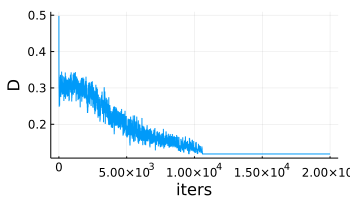

In [507]:
plot(d, size=(350,200), label="", ylabel="D", xlabel="iters")

In [508]:
ovl,dist = performance(bp)

(0.763265306122449, 0.11836734693877551)

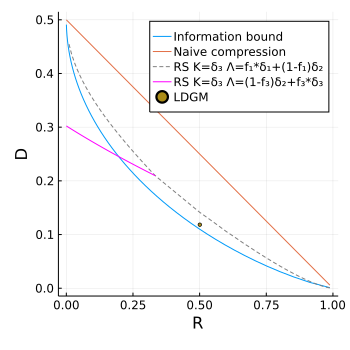

In [509]:
pl = plot_rdb()
scatter!([Rtrue], [minimum(d[.!isnan.(d)])], label="LDGM", size=(350,350), ms=2)

### The corresponding LDPC system

In [510]:
include("../code/bp_full.jl")
function findH(B)
    A = sparse(B')
    rowperm, colperm = leaf_removal(A)
    Anew = A[rowperm, colperm]
    ut2diagGF2!(Anew)
    Ht = [Anew[:, size(Anew, 1)+1:end]; I]
    indep = colperm[size(A,1)+1:end]
    H = sparse(Ht')
    H, indep
end
H, indep = findH(G)
nnz(H), nnz(G)

(134042, 10290)

In [511]:
ms1 = BPFull(H, efield);
ε,iters = iteration!(ms1; maxiter=10^3, tol=1e-12, damp=0.6, rein=1e-3, 
    update_f! = update_factor_ms!, update_v! = update_var_ms!)

(18804.553053098032, 1000)

In [512]:
nunsat, ovl, distH = performance(ms1,s)

(0, 0.6891156462585034, 0.1554421768707483)

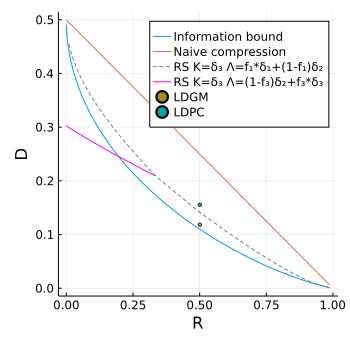

In [513]:
scatter!(pl, [Rtrue], [distH], label="LDPC", size=(350,350), ms=2)

## Varying external field strength and reinforcement

In [545]:
n, k, nedges, P, Λ = valid_degrees(Rho, Lambda, 2*3*5*7*2)
G = ldgm_matrix(n, k, nedges, Λ, P)
G = G[:,1:end-1]
Rtrue = size(G,2)/n;
s = rand((-1,1), n)   # source
bp = LDGM(G, s)
ndegree1_factors = sum(1 .== vec(sum(G,dims=2)))
@show ndegree1_factors;

ndegree1_factors = 2


In [621]:
HH = 0:0.1:2
nH = length(HH)
D = zeros(nH)
maxiter = 2*10^4
dd = [fill(NaN, maxiter) for _ in 1:nH]
@showprogress for (i,H) in enumerate(HH)
    bp.efield .= [(exp(sa*H),exp(-sa*H)) for sa in s]
    fill!(bp.u, (.5,.5)); fill!(bp.h, (.5,.5)); fill!(bp.belief, (.5,.5))
    fill!(bp.prior, (.55,.45))
    ε, niters = iteration!(bp, maxiter=1, damp=0.5, rein=0.0)
    fill!(bp.prior, (.5,.5))
    ε, niters = iteration!(bp, maxiter=maxiter, dist=dd[i], damp=0.5, rein=1e-4)
    _,D[i] = performance(bp)
end

Progress: 100%|█████████████████████████████████████████| Time: 0:08:35


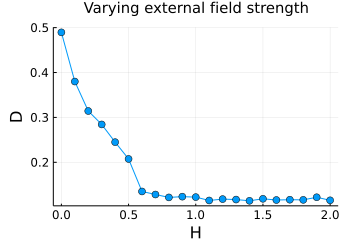

In [622]:
plot(HH, D, marker=:circle, xlabel="H", ylabel="D", label="", 
    title="Varying external field strength", size=(350,250), titlefontsize=10)

In [623]:
H = 2
efield = [(exp(sa*H),exp(-sa*H)) for sa in s]
rein = 10.0 .^ (-6.5:0.5:-3)
nrein = length(rein)
Dr = zeros(nrein)
maxiter = 10^5
ddr = [fill(NaN, maxiter) for _ in 1:nrein]
@showprogress for (i,r) in enumerate(rein)
    fill!(bp.u, (.5,.5)); fill!(bp.h, (.5,.5)); fill!(bp.belief, (.5,.5))
    fill!(bp.prior, (.55,.45)); bp.efield .= efield
    ε, niters = iteration!(bp, maxiter=1, damp=0.5, rein=0.0)
    fill!(bp.prior, (.5,.5))
    ε, niters = iteration!(bp, maxiter=maxiter, dist=ddr[i], damp=0.5, rein=r)
    _,Dr[i] = performance(bp)
end

Progress: 100%|█████████████████████████████████████████| Time: 0:10:35


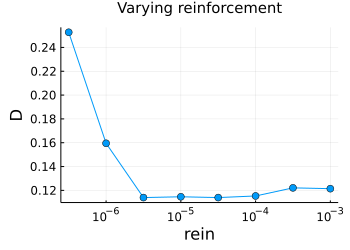

In [624]:
plot(rein, Dr, marker=:circle, xlabel="rein", ylabel="D", label="", 
    title="Varying reinforcement", size=(350,250), titlefontsize=10,
    xscale=:log10)

In [625]:
P = [plot(ddd) for ddd in ddr]
plot(P...)

In [626]:
H = 2
efield = [(exp(sa*H),exp(-sa*H)) for sa in s]
damp = 0:0.1:0.9
ndamp = length(damp)
Dd = zeros(ndamp)
maxiter = 10^5
ddd = [fill(NaN, maxiter) for _ in 1:ndamp]
@showprogress for (i,dm) in enumerate(damp)
    fill!(bp.u, (.5,.5)); fill!(bp.h, (.5,.5)); fill!(bp.belief, (.5,.5))
    fill!(bp.prior, (.55,.45)); bp.efield .= efield
    ε, niters = iteration!(bp, maxiter=1, damp=dm, rein=0.0)
    fill!(bp.prior, (.5,.5))
    ε, niters = iteration!(bp, maxiter=maxiter, dist=ddd[i], damp=dm, rein=5e-5)
    _,Dd[i] = performance(bp)
end

Progress: 100%|█████████████████████████████████████████| Time: 0:15:55


In [628]:
plot(rein, Dd, marker=:circle, xlabel="damp", ylabel="D", label="", 
    title="Varying damping", size=(350,250), titlefontsize=10,
    xscale=:log10)

BoundsError: BoundsError: attempt to access 8-element Vector{Float64} at index [1:10]

In [629]:
P = [plot(dd) for dd in ddd]
plot(P...)

## BP, varying rate
Factors of degree 2, variables of degree 1 and 2

In [195]:
rr = 0.1:0.1:0.9
# rr = [.4]
RR = zero(rr)
DD = zero(rr)
DD_sd = zero(rr)
navg = 3
n = 7200*2
H = 1
noise = 1e-4
for (i,r) in enumerate(rr)
    println("$i of ", length(rr))
    m = round(Int, n*(r))
    nedges, Λ, K = generate_polyn(n,m,degree_type=:nodes)
    D = zeros(navg)
    for j in 1:navg
        G = ldpc_matrix(n, m, nedges, Λ, K)
#         G = G[:,1:end-1];
        RR[i] = size(G,2)/n
        s = rand((-1,1), n)   # source
        efield = [(exp(ss*H),exp(-ss*H)) for ss in s]
#         efield = [(ss*H+noise*randn(),-ss*H+noise*randn()) for ss in s]
        bp = LDGM(G, s, efield);
        rand_msg!(bp.prior, ()->0.5+noise*randn())
#         ε, niters = iteration!(bp, maxiter=5*10^2, damp=0.5, rein=1e-3,
#             update_v! = update_var_ms!, update_f! = update_factor_ms!)
        ε, niters = iteration!(bp, maxiter=5*10^2, damp=0.5, rein=1e-3)
        ovl, D[j] = performance(bp)
        @show D[j], ε, niters
        D[j] > 0.2 && (global MS = bp)
    end
    DD[i] = mean(D)
    DD_sd[i] = std(D)/sqrt(navg)
end

1 of 9
(D[j], ε, niters) = (0.3318055555555556, 0.004176657861717503, 500)
(D[j], ε, niters) = (0.3325694444444444, 0.004684892656752315, 500)
(D[j], ε, niters) = (0.33361111111111114, 0.0035965904321630937, 500)
2 of 9
(D[j], ε, niters) = (0.2642361111111111, 0.004831232881037817, 500)
(D[j], ε, niters) = (0.26458333333333334, 0.004580258355514122, 500)
(D[j], ε, niters) = (0.26534722222222223, 0.005628580670300809, 500)
3 of 9
(D[j], ε, niters) = (0.21375, 0.005240732326223324, 500)
(D[j], ε, niters) = (0.2145138888888889, 0.006888860352716075, 500)
(D[j], ε, niters) = (0.21340277777777777, 0.004867344481462088, 500)
4 of 9
(D[j], ε, niters) = (0.17118055555555556, 0.005088674684020411, 500)
(D[j], ε, niters) = (0.17048611111111112, 0.004368951584660941, 500)
(D[j], ε, niters) = (0.1696527777777778, 0.006615675438702673, 500)
5 of 9
(D[j], ε, niters) = (0.1388888888888889, 0.006116323171418442, 500)
(D[j], ε, niters) = (0.13965277777777776, 0.005077871154429869, 500)
(D[j], ε, niters

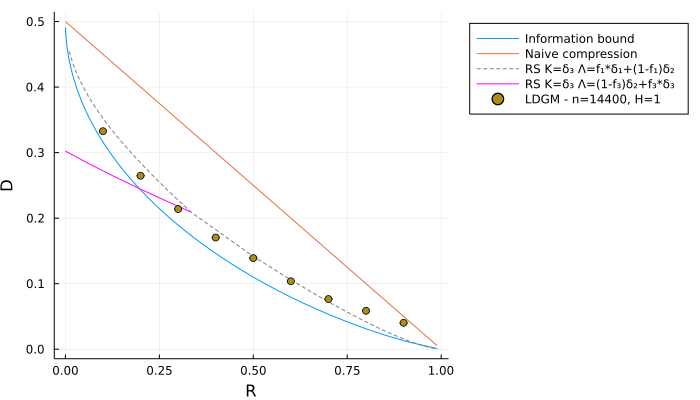

In [196]:
plot_rdb()
scatter!(RR,DD, label="LDGM - n=$n, H=$H", yerr=DD_sd, legend=:outertopright, size=(700,400))

## Max-Sum

Factors of degree 2, variables of degree 1 and 2

In [166]:
function rand_msg!(v, f=rand())
   for i in eachindex(v)
        v[i] = (f(),f())
    end
    v
end   
function rand_msg(N::Int, f=rand())
     v = zeros(N)
     rand_msg!(v, f)
end

rand_msg (generic function with 2 methods)

In [131]:
# rand_msg!(ms.u, ()->noise*randn())
# rand_msg!(ms.h, ()->noise*randn())
# rand_msg!(ms.belief, ()->noise*randn())
# rand_msg!(ms.prior, ()->noise*randn());

In [286]:
n = 7200*2
@show n
r = 0.4
m = round(Int, n*(r))
nedges, Λ, K = generate_polyn(n,m,degree_type=:nodes)
b = 0
G = ldpc_matrix(n, m, nedges, Λ, K)
# remove b factors
G = G[:,1:end-b];

n = 14400


In [634]:
r = 0.5
k=floor(Int, 2/r)
s=k+1-2/r
Λ=[fill(0,k-1); s; 1-s]
Λ .*= Λ .> 1e-10
Λ ./ sum(Λ)
K = [0,1]
n = 7200*2
k = round(Int, n*r)
nedges = 2n
G = ldgm_matrix(n, k, nedges, Λ, K);

In [635]:
k = size(G,2)
noise = 1e-4
R = k/n
H = 1
s = rand((-1,1), n)   # source
efield = [(ss*H+noise*randn(),-ss*H+noise*randn()) for ss in s]
ms = LDGM(G, s, efield)
rand_msg!(ms.prior, ()->noise*randn());

In [636]:
maxiter = 5000
dist1 = zeros(maxiter)
ε, niters = iteration!(ms, maxiter=maxiter, damp=0.5, dist=dist1, rein=1e-4,
    update_v! = update_var_ms!, update_f! = update_factor_ms!)

(0.7860802681199754, 5000)

In [637]:
ms = LDGM(G, s, efield)
rand_msg!(ms.prior, ()->noise*randn());
dist2 = zeros(maxiter)
ε, niters = iteration!(ms, maxiter=maxiter, damp=0.5, dist=dist2, rein=0.0,
    update_v! = update_var_ms!, update_f! = update_factor_ms!)

(3.075694676162159, 5000)

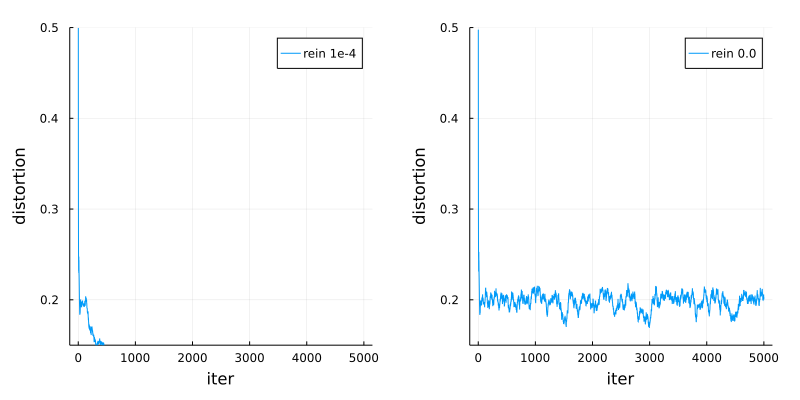

In [638]:
p1 = plot(dist1, xlabel="iter", ylabel="distortion", label="rein 1e-4", ylims=(0.15,0.5))
p2 = plot(dist2, xlabel="iter", ylabel="distortion", label="rein 0.0", ylims=(0.15,0.5))
plot(p1,p2, size=(800,400), margins=5Plots.mm)

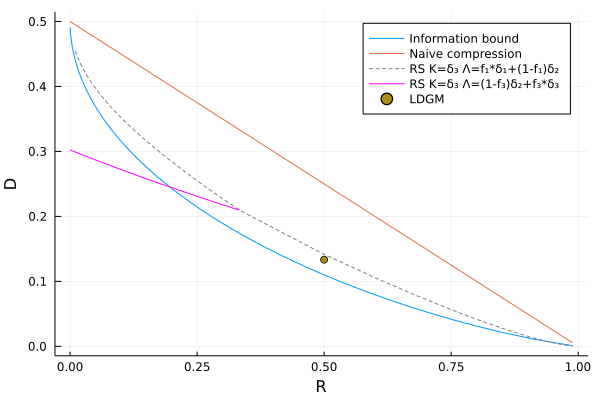

In [640]:
ovl,d = performance(ms)
pl = plot_rdb()
scatter!([R], [minimum(dist1)], label="LDGM")

In [657]:
F = free_energy(ms)

1.1256608048401278